# Load example load profiles from dataset and illustration of load distributions (prior & posterior)

In [1]:
# Hack to emulate running notebook from root directory.
import os
os.chdir('..')

In [71]:
import os
from copy import deepcopy
import numpy as np
import pandas as pd

from itertools import product
from utils import scale_profile
from utils.plotting import lighten_color
from utils.plotting import init_profile_fig, add_profile
from prob_models import prior_model, posterior_model

import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

In [46]:
from experiments.configs.config import *

In [47]:
all_ids = deepcopy(ids)
all_years = deepcopy(years)

In [4]:
np.random.seed(0)

**Note**: reproducibility is not possible with this script as Stan cannot be seeded

## Plot example building load profiles from dataset

In [79]:
ids = [0,40,104]
years = [2014,2015,2016]
colors = plt.rcParams['axes.prop_cycle'].by_key()['color']
dark_colors = [mcolors.rgb2hex(plt.cm.tab20b.colors[0])] + [mcolors.rgb2hex(c) for c in plt.cm.Dark2.colors]
lighten = [1,0.6,1.3]

period = 24*7+1
starts = [24*31,24*185]
seasons = ['winter','summer']

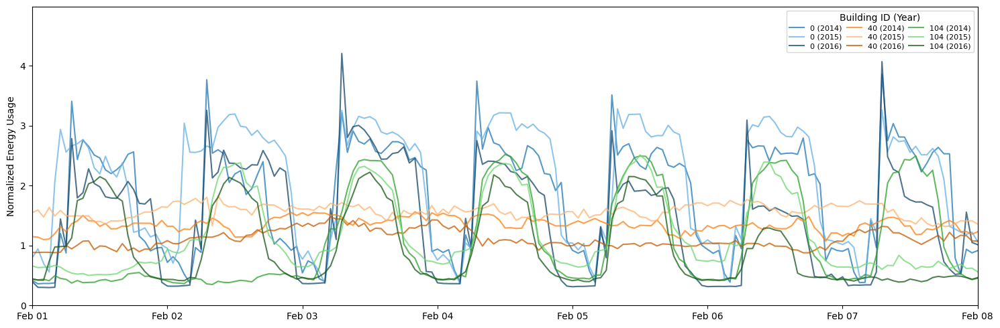

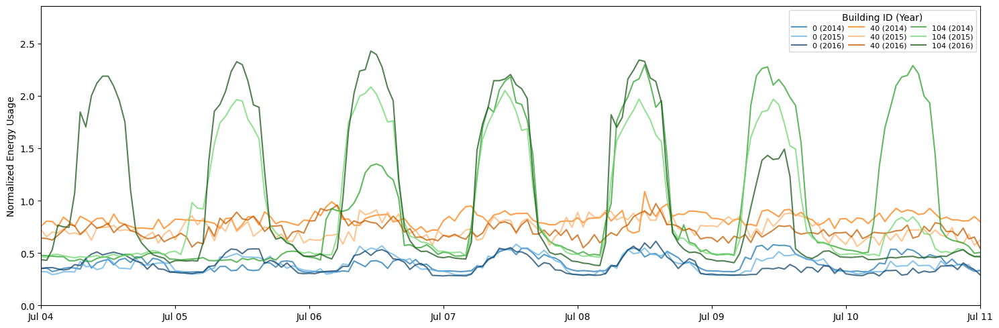

In [28]:
for offset,season in zip(starts,seasons):
    fig,ax = plt.subplots(figsize=(15,5))

    for (i,building_id),(j,year) in product(enumerate(ids),enumerate(years)):

        original_building_file = pd.read_csv(os.path.join(dataset_dir, building_fname_pattern.format(id=int(building_id), year=int(year))))
        profile = original_building_file['Equipment Electric Power [kWh]'].to_numpy()
        profile = profile/profile.mean()

        start = pd.to_datetime("01/01/2000") + pd.DateOffset(hours=offset)
        trange = pd.date_range(start=start, periods=period, freq='h')

        plt.plot(
            trange,
            profile[offset:offset+period],
            label=f'{building_id} ({year})',
            alpha=0.75,
            color=lighten_color(colors[i],lighten[j]),
        )

    plt.gca().xaxis.set_major_formatter(plt.matplotlib.dates.DateFormatter('%b %d'))
    plt.xlim(trange[0],trange[-1])
    plt.margins(y=0.2)
    plt.ylim(0)
    plt.ylabel('Normalized Energy Usage')
    plt.legend(title="Building ID (Year)",loc='upper right', ncol=len(ids), labelspacing=0.3, columnspacing=0.6, fontsize=8)
    plt.tight_layout()
    plt.savefig(os.path.join('plots',f'load_data_{season}.pdf'))
    plt.show()

Plot all load profiles in interactive plot for webpage

In [90]:
fig = init_profile_fig(y_titles={'y1':'Normalized Energy Usage'})

for (i,building_id),(j,year) in product(enumerate(all_ids),enumerate(all_years)):

    original_building_file = pd.read_csv(os.path.join(dataset_dir, building_fname_pattern.format(id=int(building_id), year=int(year))))
    profile = original_building_file['Equipment Electric Power [kWh]'].to_numpy()
    profile = profile/profile.mean()

    fig = add_profile(
        fig,
        profile,
        name=year,
        legendgroup=building_id,
        legendgrouptitle_text=f'Building {building_id}',
        line=dict(
            color=f'rgb{lighten_color(dark_colors[i],lighten[j%3])}',
            width=3,
            dash='dot' if j//3==1 else None
        ),
        visible=True if (j==0 and i<4) else 'legendonly',
        hovertemplate ='Time: %{x}'+'<br>Norm load: %{y:.3f}',
    )

fig.update_layout(
    legend=dict(
        title="Load year",
        orientation="v",
        x=1,
        xanchor='center',
        y=1,
        yanchor='top',
        groupclick="toggleitem"
    )
)

fig['layout']['xaxis'].update(range=['2000-04-24','2000-05-01'])
fig.update_layout(title=dict(
    text='Normalized building energy usage dataset',
    y=0.95,
    x=0.5,
    xanchor='center',
    yanchor='top'
))
fig.write_html(f'load_dataset_plot.html')

fig.show()

/Users/mal84/Documents/Repositories/Building-Design-VoI/utils/plotting.py:95: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

/Users/mal84/Documents/Repositories/Building-Design-VoI/utils/plotting.py:95: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

/Users/mal84/Documents/Repositories/Building-Design-VoI/utils/plotting.py:95: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

/Users/mal84/Documents/Repositories/Building-Design-VoI/utils/plotting.py:95: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

/Users/mal84/Documents/Repositories/Building-Design-VoI/utils/plotting.py:95: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

/Users/mal84/Documents/Repositories/Building-Design-VoI/utils/plotting.py:95: FutureWarning:

'H' is deprecate

## Plot load distributions (prior & posterior)

In [7]:
nsamples = 1000
ntraces = 25

In [8]:
thetas, zs = prior_model(1, nsamples, prob_config)

In [9]:
sampled_profiles = []
for n in range(nsamples):
    b_id,year,mean,peak = thetas[n].flatten()
    original_building_file = pd.read_csv(os.path.join(dataset_dir, building_fname_pattern.format(id=int(b_id), year=int(year))))
    profile = original_building_file['Equipment Electric Power [kWh]'].to_numpy()
    scaled_profile = scale_profile(profile, mean, peak)
    sampled_profiles.append(scaled_profile)

mean_profile = np.mean(sampled_profiles,axis=0)
profiles_sd = np.std(sampled_profiles,axis=0)

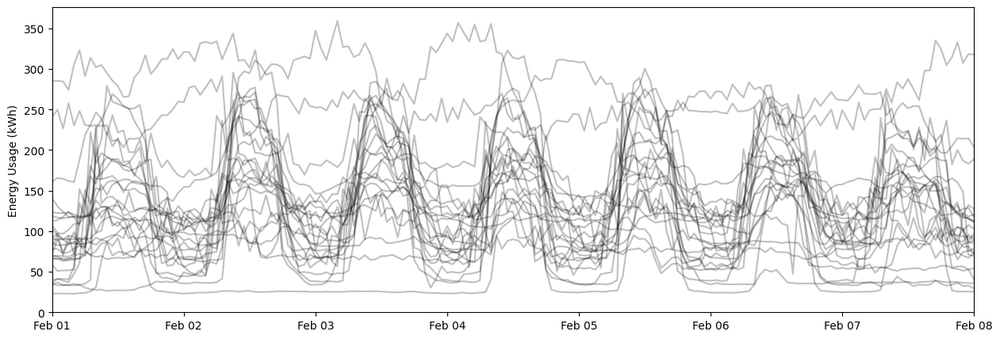

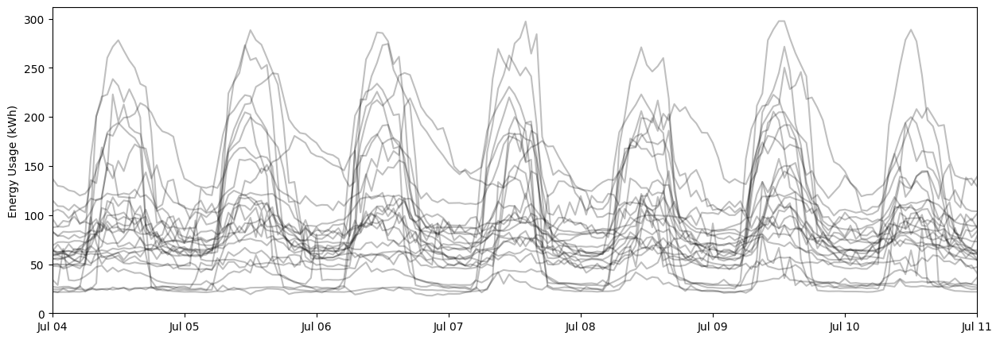

In [10]:
for offset,season in zip(starts,seasons):
    fig,ax = plt.subplots(figsize=(15,5))

    start = pd.to_datetime("01/01/2000") + pd.DateOffset(hours=offset)
    trange = pd.date_range(start=start, periods=period, freq='h')

    for prof in sampled_profiles[:25]:
        plt.plot(
            trange,
            prof[offset:offset+period],
            alpha=0.25,
            c='k'
        )

    plt.gca().xaxis.set_major_formatter(plt.matplotlib.dates.DateFormatter('%b %d'))
    plt.xlim(trange[0],trange[-1])
    plt.ylim(0)
    plt.ylabel('Energy Usage (kWh)')
    plt.show()

Plot distributions

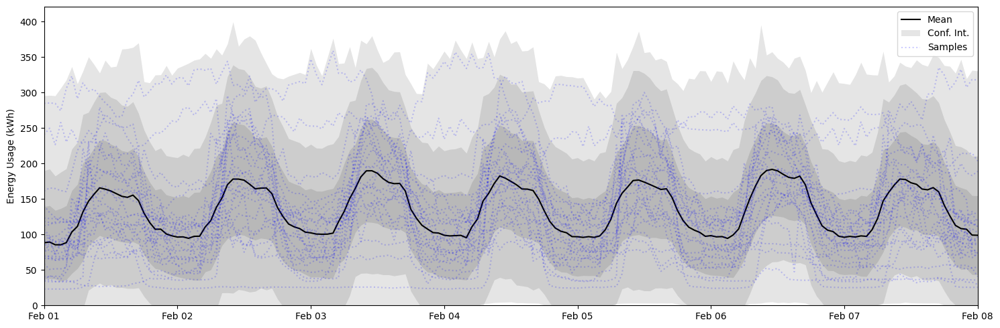

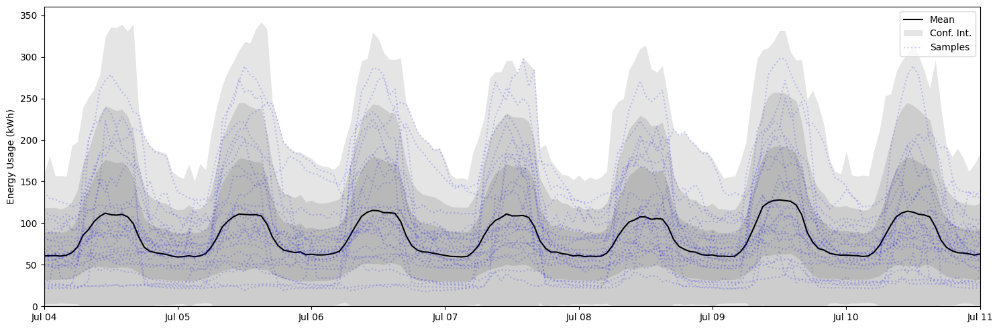

In [29]:
for offset,season in zip(starts,seasons):
    fig,ax = plt.subplots(figsize=(15,5))

    start = pd.to_datetime("01/01/2000") + pd.DateOffset(hours=offset)
    trange = pd.date_range(start=start, periods=period, freq='h')

    plt.plot(
            trange,
            mean_profile[offset:offset+period],
            alpha=1,
            c='k',
            label='Mean'
        )
    plt.fill_between(
        trange,
        np.min(sampled_profiles,axis=0)[offset:offset+period],
        np.max(sampled_profiles,axis=0)[offset:offset+period],
        alpha=0.1,
        color='k',
        lw=0,
        label='Conf. Int.'
    )
    for k in range(1,3):
        plt.fill_between(
            trange,
            mean_profile[offset:offset+period] - k*profiles_sd[offset:offset+period],
            mean_profile[offset:offset+period] + k*profiles_sd[offset:offset+period],
            alpha=0.1,
            color='k',
            lw=0
        )
    for i,prof in enumerate(sampled_profiles[:ntraces]):
        plt.plot(
            trange,
            prof[offset:offset+period],
            alpha=0.2,
            c='b',
            ls=':',
            label='Samples' if i==0 else None
        )

    plt.gca().xaxis.set_major_formatter(plt.matplotlib.dates.DateFormatter('%b %d'))
    plt.xlim(trange[0],trange[-1])
    plt.ylim(0)
    plt.ylabel('Energy Usage (kWh)')
    plt.legend()
    plt.tight_layout()
    plt.savefig(os.path.join('plots',f'prior_load_dist_{season}.pdf'))
    plt.show()

Repeat for posterior

In [25]:
z_year = 2012
z_id,_,z_mean,z_peak = zs[50].flatten()
varthetas = posterior_model([z_id],[z_mean],[z_peak],nsamples,prob_config)
print(z_id,z_mean,z_peak)

104.0 121.6 314.9


In [26]:
original_building_file = pd.read_csv(os.path.join(dataset_dir, building_fname_pattern.format(id=int(z_id), year=int(z_year))))
profile = original_building_file['Equipment Electric Power [kWh]'].to_numpy()
z_profile = scale_profile(profile, z_mean, z_peak)

vartheta_profiles = []
for n in range(nsamples):
    b_id,year,mean,peak = varthetas[n].flatten()
    original_building_file = pd.read_csv(os.path.join(dataset_dir, building_fname_pattern.format(id=int(b_id), year=int(year))))
    profile = original_building_file['Equipment Electric Power [kWh]'].to_numpy()
    scaled_profile = scale_profile(profile, mean, peak)
    vartheta_profiles.append(scaled_profile)

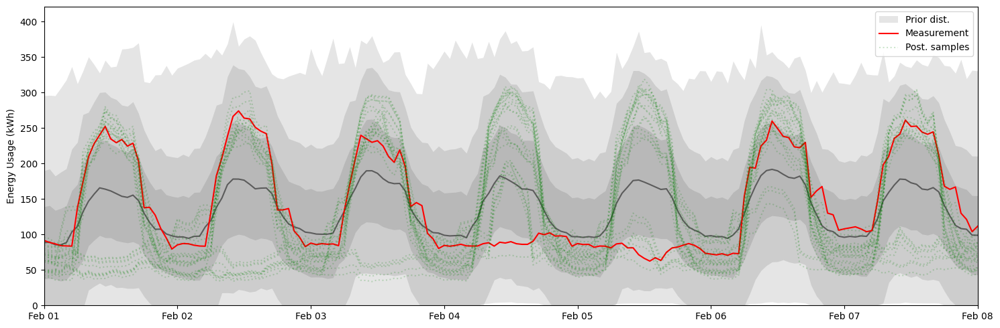

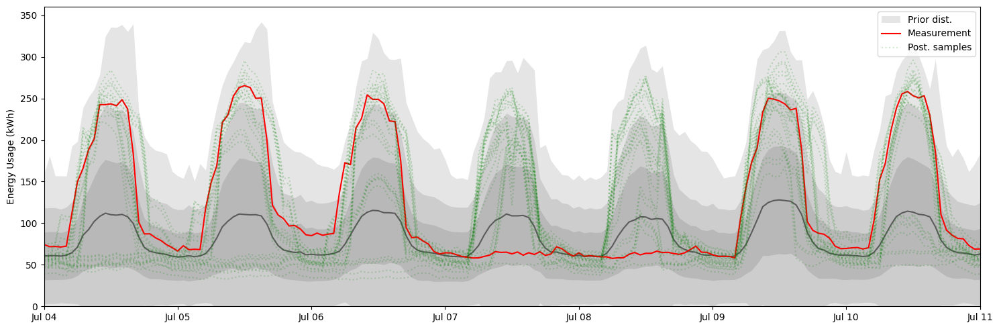

In [89]:
for offset,season in zip(starts,seasons):
    fig,ax = plt.subplots(figsize=(15,5))

    start = pd.to_datetime("01/01/2000") + pd.DateOffset(hours=offset)
    trange = pd.date_range(start=start, periods=period, freq='h')

    plt.fill_between(
        trange,
        np.min(sampled_profiles,axis=0)[offset:offset+period],
        np.max(sampled_profiles,axis=0)[offset:offset+period],
        alpha=0.1,
        color='k',
        lw=0,
        label='Prior dist.'
    )
    for k in range(1,3):
        plt.fill_between(
            trange,
            mean_profile[offset:offset+period] - k*profiles_sd[offset:offset+period],
            mean_profile[offset:offset+period] + k*profiles_sd[offset:offset+period],
            alpha=0.1,
            color='k',
            lw=0
        )
    plt.plot(
        trange,
        mean_profile[offset:offset+period],
        alpha=0.5,
        c='k'
    )

    plt.plot(
        trange,
        z_profile[offset:offset+period],
        alpha=1,
        c='r',
        label='Measurement'
    )
    for i,prof in enumerate(vartheta_profiles[:ntraces]):
        plt.plot(
            trange,
            prof[offset:offset+period],
            alpha=0.2,
            c='g',
            ls=':',
            label='Post. samples' if i==0 else None
        )

    plt.gca().xaxis.set_major_formatter(plt.matplotlib.dates.DateFormatter('%b %d'))
    plt.xlim(trange[0],trange[-1])
    plt.ylim(0)
    plt.ylabel('Energy Usage (kWh)')
    plt.legend(loc='upper right')
    plt.tight_layout()
    plt.savefig(os.path.join('plots',f'post_load_dist_{season}.pdf'))
    plt.show()